In [1]:
import pandas as pd
import numpy as np
import os

In [2]:
df = pd.read_pickle('data/final_dataframe.pkl')

In [3]:
for i in df['Photovoltaics [MWh] Original resolutions']:
    print(i, type(i))

0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
0.0 <class 'float'>
1.75 <class 'float'>
14.75 <class 'float'>
56.75 <class 'float'>
135.0 <class 'float'>
255.0 <class 'float'>
407.0 <class 'float'>
588.0 <class 'float'>
759.5 <class 'float'>
958.5 <class 'float'>
1190.0 <class 'float'>
1388.75 <class 'float'>
1602.25 <class 'float'>
1795.0 <class 'float'>
2002.5 <class 'float'>
2214.75 <class 'float'>
2351.5 <class 'float'>
2419.75 <class 'float'>
2523.0 <class 'float'>
2622.75 <class 'float'>
2673.5 <

In [4]:
def replace_comma(df):
    df['Photovoltaics [MWh] Original resolutions'] = df['Photovoltaics [MWh] Original resolutions'].replace(',', '',regex=True)
    df['Photovoltaics [MWh] Original resolutions'] = df['Photovoltaics [MWh] Original resolutions'].astype(float)

    df['Total (grid load) [MWh] Original resolutions'] = df['Total (grid load) [MWh] Original resolutions'].replace(',', '',regex=True)
    df['Total (grid load) [MWh] Original resolutions'] = df['Total (grid load) [MWh] Original resolutions'].astype(float)
    return df

In [5]:
replace_comma(df)

,Date,Photovoltaics [MWh] Original resolutions,Photovoltaics [MW] Calculated resolutions,Total (grid load) [MWh] Original resolutions,Germany/Luxembourg [€/MWh] Calculated resolutions
0,2018-10-01 00:00:00,0.0,42805,NaN,59.53
1,2018-10-01 00:15:00,0.0,42805,NaN,59.53
2,2018-10-01 00:30:00,0.0,42805,NaN,59.53
3,2018-10-01 00:45:00,0.0,42805,NaN,59.53
4,2018-10-01 01:00:00,0.0,42805,10589.75,56.10
...,...,...,...,...,...
163675,2023-06-01 22:45:00,0.0,62579,12945.50,95.41
163676,2023-06-01 23:00:00,0.0,62579,12817.75,86.53
163677,2023-06-01 23:15:00,0.0,62579,12539.00,86.53
163678,2023-06-01 23:30:00,0.0,62579,12371.00,86.53


the replace somma function finally worked out regex = TRUE is essential otherwise it looks for exact match in a cell

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163680 entries, 0 to 163679
Data columns (total 5 columns):
 #   Column                                             Non-Null Count   Dtype         
---  ------                                             --------------   -----         
 0   Date                                               163680 non-null  datetime64[ns]
 1   Photovoltaics [MWh] Original resolutions           163676 non-null  float64       
 2   Photovoltaics [MW] Calculated resolutions          163680 non-null  int64         
 3   Total (grid load) [MWh] Original resolutions       163664 non-null  float64       
 4   Germany/Luxembourg [€/MWh] Calculated resolutions  163680 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(1)
memory usage: 6.2 MB


##Le'ts now look into the missing values and see if we can interpolate them correctly
first i will try the fill na function

In [7]:
def fill_na_timeseries(df): 
    ''' first apply forward fill to replace the missing vlaues in the beginning of the time series 
    followed by a backfill to replace the missing values in the end of the time series '''
    df.fillna(method= 'ffill', inplace=True)
    df.fillna(method= 'bfill', inplace=True)
    return df

In [8]:
fill_na_timeseries(df)

,Date,Photovoltaics [MWh] Original resolutions,Photovoltaics [MW] Calculated resolutions,Total (grid load) [MWh] Original resolutions,Germany/Luxembourg [€/MWh] Calculated resolutions
0,2018-10-01 00:00:00,0.0,42805,10589.75,59.53
1,2018-10-01 00:15:00,0.0,42805,10589.75,59.53
2,2018-10-01 00:30:00,0.0,42805,10589.75,59.53
3,2018-10-01 00:45:00,0.0,42805,10589.75,59.53
4,2018-10-01 01:00:00,0.0,42805,10589.75,56.10
...,...,...,...,...,...
163675,2023-06-01 22:45:00,0.0,62579,12945.50,95.41
163676,2023-06-01 23:00:00,0.0,62579,12817.75,86.53
163677,2023-06-01 23:15:00,0.0,62579,12539.00,86.53
163678,2023-06-01 23:30:00,0.0,62579,12371.00,86.53


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163680 entries, 0 to 163679
Data columns (total 5 columns):
 #   Column                                             Non-Null Count   Dtype         
---  ------                                             --------------   -----         
 0   Date                                               163680 non-null  datetime64[ns]
 1   Photovoltaics [MWh] Original resolutions           163680 non-null  float64       
 2   Photovoltaics [MW] Calculated resolutions          163680 non-null  int64         
 3   Total (grid load) [MWh] Original resolutions       163680 non-null  float64       
 4   Germany/Luxembourg [€/MWh] Calculated resolutions  163680 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(1)
memory usage: 6.2 MB


now to make the df a bit easier to work with replce the column names with simpler names 

In [10]:
column_names = {'Photovoltaics [MWh] Original resolutions': 'Solar_generation_MWh',
                'Photovoltaics [MW] Calculated resolutions': 'Solar_installed_MW',
                'Total (grid load) [MWh] Original resolutions': 'Total_consumption_MWh',
                'Germany/Luxembourg [€/MWh] Calculated resolutions': 'DE_LU_price_per_MWh',}



In [11]:
df.rename(columns=column_names, inplace=True)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163680 entries, 0 to 163679
Data columns (total 5 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   Date                   163680 non-null  datetime64[ns]
 1   Solar_generation_MWh   163680 non-null  float64       
 2   Solar_installed_MW     163680 non-null  int64         
 3   Total_consumption_MWh  163680 non-null  float64       
 4   DE_LU_price_per_MWh    163680 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(1)
memory usage: 6.2 MB


In [19]:
df.set_index(df['Date'], inplace=True)

In [34]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


In [20]:
px.line(df, y="Solar_generation_MWh", x="Date")

In [21]:
#%pip install pmdarima==2.0.3


  Using cached pmdarima-2.0.3-cp311-cp311-macosx_11_0_arm64.whl (574 kB)
  Using cached Cython-0.29.35-py2.py3-none-any.whl (988 kB)
Note: you may need to restart the kernel to use updated packages.


In [22]:
import requests
import csv
from itertools import permutations
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import mean_squared_error
from math import sqrt
from statsmodels.tsa.stattools import adfuller,kpss
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.graphics.tsaplots import plot_pacf

from pmdarima.arima import auto_arima
import statsmodels.graphics.tsaplots as tsaplot
from statsmodels.tsa.holtwinters import Holt, ExponentialSmoothing, SimpleExpSmoothing


In [26]:
df['Solar_generation_MWh']

Date
2018-10-01 00:00:00    0.0
2018-10-01 00:15:00    0.0
2018-10-01 00:30:00    0.0
2018-10-01 00:45:00    0.0
2018-10-01 01:00:00    0.0
                      ... 
2023-06-01 22:45:00    0.0
2023-06-01 23:00:00    0.0
2023-06-01 23:15:00    0.0
2023-06-01 23:30:00    0.0
2023-06-01 23:45:00    0.0
Name: Solar_generation_MWh, Length: 163680, dtype: float64

In [27]:
# Lets start decomposing the data 

# Check decomposition of trend, seasonality and residue of original time series
decomposition = seasonal_decompose(x=df['Solar_generation_MWh'], 
                                   model='additive',  # Why multiplicative and not additive? additive only with constant patterns, multiplicative variing pattern 
                                    period = 96)

In [36]:
fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Line(decomposition.observed),
    row=1, col=1
)

fig.add_trace(
    go.Line(decomposition.trend),
    row=2, col=1
)

fig.add_trace(
    go.Line(decomposition.seasonal),
    row=2, col=1
)



fig.update_layout(height=600, width=800, title_text="Side By Side Subplots")
fig.show()

/Users/annawey/git/NeueFische/EES_Optimisation/.venv/lib/python3.11/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




TypeError: keywords must be strings

In [29]:
px.line(decomposition.observed)

In [30]:
px.line(decomposition.trend)

In [31]:
px.line(decomposition.seasonal)

NameError: name 'sns_c' is not defined

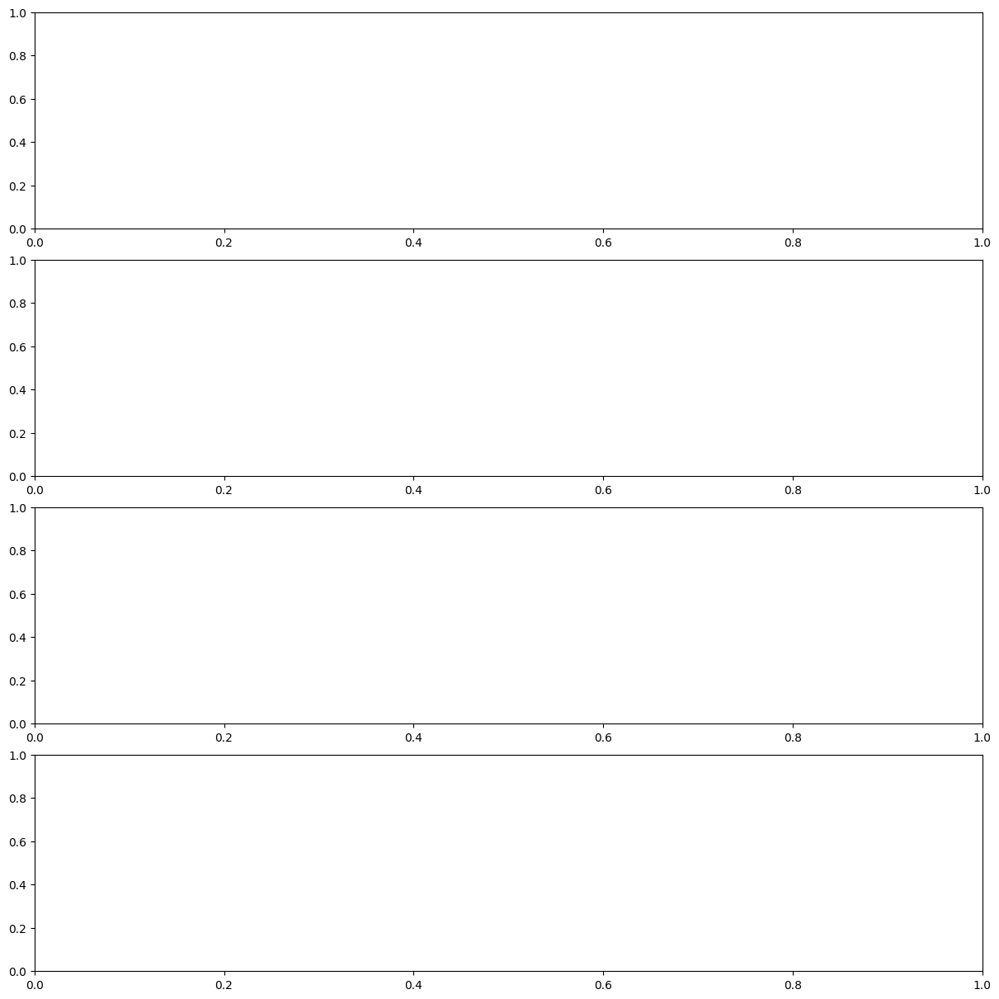

In [28]:
fig, ax = plt.subplots(4, 1, figsize=(12, 12), constrained_layout=True)
decomposition.observed.plot(c=sns_c[0], ax=ax[0])
ax[0].set(title='Close')
decomposition.trend.plot(c=sns_c[1], ax=ax[1])
ax[1].set(title='trend')
decomposition.seasonal.plot(c=sns_c[2], ax=ax[2])
ax[2].set(title='seasonal')
decomposition.resid.plot(c=sns_c[3], ax=ax[3])
ax[3].set(title='residual')
fig.set_size_inches(20, 10);